In [70]:
# imports
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.metrics import accuracy_score, classification_report
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
import json
import re
from sklearn.feature_selection import SelectKBest, f_classif, RFE
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
# Load the JSON data
with open('../data/extracted_and_reformatted_data.json', 'r') as file:
    json_data = json.load(file)

[{'entryId': 47810,
  'browserData': 'Host: frieza.herokuapp.com\nConnection: close\nUser-Agent: Mozilla/5.0 (Linux; Android 9.0; SM-T295N) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/74.0.3729.108 Mobile Safari/537.36\nContent-Type: application/json;charset=UTF-8\nAccept: */*\nCookie: friezaId=9a81ec5ebfb5197c5534b584ca7d37f33652e29ed9d556c03ef7ebbc986b7b8b\nOrigin: https://frieza.herokuapp.com\nReferer: https://frieza.herokuapp.com/R8Qw4IKChe/home\nAccept-Encoding: gzip, deflate, br\nAccept-Language: en-US\nX-Request-Id: 74e23033-e30c-4daa-8a3f-028d97cc6e13\nX-Forwarded-For: f70c9e2fa141c67ba560e2dc7ace76c4cc58e6ba2967a1c9a21daafc7c53507f\nX-Forwarded-Proto: https\nX-Forwarded-Port: 443\nVia: 1.1 vegur\nConnect-Time: 0\nX-Request-Start: 1698015869350\nTotal-Route-Time: 0\nContent-Length: 21236\n\n',
  'operationDetails': "{'executableName': 'D', 'executableDuration': 70000, 'profilerDuration': 60000, 'numTimeOps': 1000, 'operationToTime': 'rng', 'sleepDuration': 50}",
  'operationO
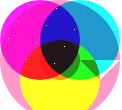
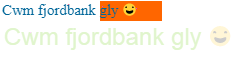
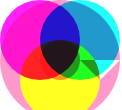
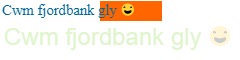
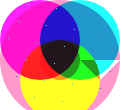
...
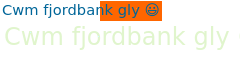
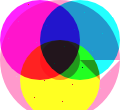
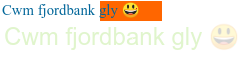
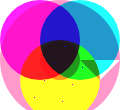
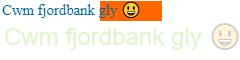

In [8]:
json_data

In [8]:
'''
Preprocessing
'''

df = pd.DataFrame(json_data)

def json_loads(s):
    s = re.sub(r"(?<!\\)'", '"', s)
    return json.loads(s)

# Deserialization of the JSON data
df['operationDetails'] = df['operationDetails'].apply(json_loads)
df['operationOutput'] = df['operationOutput'].apply(json_loads)
df['operationOutput'] = df['operationOutput'].apply(lambda x: np.array(x))


# Determine the plaform of the data
def determine_platform(platform):
    if 'Linux' in platform:
        return 'Linux'
    elif 'Win' in platform:
        return 'Windows'
    elif 'iPad' in platform or 'iPhone' in platform:
        # return 'iOS'
        return 'macOS'
    elif 'Mac' in platform:
        return 'macOS'
    else:
        return 'Other'

# Get the platform from component
df['platform'] = df['components'].apply(lambda x: determine_platform(x['platform']['value']))

# Remove linux data
df = df[df['platform'] != 'Linux']

# Remove non executableName.exec_step
df = df[df['operationDetails'].apply(lambda x: x['executableName']) == 'exec_step']

# Compute summary statistics for each operationOutput
df['median'] = df['operationOutput'].apply(np.median)
df['mean'] = df['operationOutput'].apply(np.mean)
df['std'] = df['operationOutput'].apply(np.std)
df['min'] = df['operationOutput'].apply(np.min)
df['max'] = df['operationOutput'].apply(np.max)

# Set a fixed length of the operationOutput
# fixed_length = 256
# df['operationOutput'] = df['operationOutput'].apply(
#     lambda x: np.pad(x[:fixed_length], (0, max(0, fixed_length - len(x))), 'constant')
# )

df

,entryId,browserData,operationDetails,operationOutput,components,platform,median,mean,std,min,max
3,31066,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[6.714999675750732, 19.454999826848507, 17.815...","{'fonts': {'value': [], 'duration': 102}, 'dom...",macOS,34.2575,82.647259,297.850004,3.180000,6267.905
6,32059,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[38.16500003449619, 11.799999978393316, 37.215...","{'fonts': {'value': [], 'duration': 46}, 'domB...",macOS,109.1050,168.619986,460.861600,5.735000,7118.885
7,26061,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[134.0100000379607, 321.53999991714954, 753.10...","{'fonts': {'value': [], 'duration': 2343}, 'do...",Windows,871.9925,982.373306,546.730320,97.235000,2533.650
8,52602,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[31.884999945759773, 1512.275000102818, 2693.9...","{'fonts': {'value': [], 'duration': 2415}, 'do...",Windows,868.9150,2038.799394,2976.878150,31.885000,12178.610
9,32049,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[9.934999980032444, 18.99999985471368, 20.5949...","{'fonts': {'value': [], 'duration': 93}, 'domB...",Windows,66.5500,99.821944,236.847531,5.305000,3701.610
...,...,...,...,...,...,...,...,...,...,...,...
54022,23278,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[14.710000017657876, 88.61500001512468, 29.815...","{'fonts': {'value': [], 'duration': 196}, 'dom...",macOS,309.1425,519.105189,1348.165838,6.165000,14870.395
54023,29869,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[16.580000519752502, 8.229999803006649, 279.88...","{'fonts': {'value': [], 'duration': 2569}, 'do...",Windows,143.7400,248.214240,669.334743,6.285001,9514.525
54024,43047,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[1280.7550001889467, 1033.9449997991323, 632.3...","{'fonts': {'value': [], 'duration': 2273}, 'do...",Windows,1109.9900,1926.140909,1611.595718,428.265000,5705.545
54026,15611,Host: frieza.herokuapp.com\nConnection: close\...,"{'executableName': 'exec_step', 'executableDur...","[32.44499955326319, 26.405000127851963, 49.999...","{'fonts': {'value': [], 'duration': 66}, 'domB...",macOS,30.7050,76.338259,272.753797,4.100000,5244.410


In [54]:
'''
Get statistics from the data
'''

# Get the number of entries per platform and print the percentage
print(df['platform'].value_counts())
print(df['platform'].value_counts(normalize=True))

platform
Windows    20099
macOS      16412
Name: count, dtype: int64
platform
Windows    0.550492
macOS      0.449508
Name: proportion, dtype: float64


In [85]:
'''
Feature Engineering
'''
# Select the features and target variable
features = ['median', 'mean', 'std', 'min', 'max']
selected_features = ['min', 'std', 'mean']
X = df[selected_features]
y = df['platform']

# Encode the target variable
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# # Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [86]:
'''
Train Test Split
'''

X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)
print(X_train)
print(y_train)

             min          std         mean
7528    7.395000  3220.505736  1353.780900
12541   2.765000   599.368215   102.650911
23390   3.130000   864.263558   466.036318
47368   4.095000    43.022119    14.983668
32774   5.819999   397.083598   186.017508
...          ...          ...          ...
24980   3.430000   718.786616   160.034867
9339   15.935000   876.099827   998.385250
16844   0.000000   463.799449   102.353413
1264    7.755000  1472.528315   712.065057
23424   2.670000    51.299714    14.599051

[29208 rows x 3 columns]
[1 1 0 ... 0 1 1]


In [87]:
'''
Model
'''

knn = KNeighborsClassifier(n_neighbors=2, n_jobs=-1)
knn.fit(X_train, y_train)

KNeighborsClassifier(n_jobs=-1, n_neighbors=2)

In [88]:
'''
Evaluation
'''

y_pred = knn.predict(X_test)
print(f'Train Accuracy: {accuracy_score(y_train, knn.predict(X_train)):.2f}')
print(f'Test Accuracy: {accuracy_score(y_test, y_pred):.2f}')
print(classification_report(y_test, y_pred, target_names=label_encoder.classes_))

Train Accuracy: 0.75
Test Accuracy: 0.54
              precision    recall  f1-score   support

     Windows       0.56      0.80      0.66      4071
       macOS       0.45      0.20      0.28      3232

    accuracy                           0.54      7303
   macro avg       0.50      0.50      0.47      7303
weighted avg       0.51      0.54      0.49      7303



In [78]:
'''
Evaluation
'''

print(f'Train Accuracy: {accuracy_score(y_train, knn.predict(X_train)):.2f}')
y_pred = knn.predict(X_test)
print(f'Test Accuracy: {accuracy_score(y_test, y_pred):.2f}')
print(classification_report(y_test, y_pred, target_names=label_encoder.classes_))

Train Accuracy: 0.75
Test Accuracy: 0.54
              precision    recall  f1-score   support

     Windows       0.56      0.80      0.66      4071
       macOS       0.45      0.20      0.28      3232

    accuracy                           0.54      7303
   macro avg       0.51      0.50      0.47      7303
weighted avg       0.51      0.54      0.49      7303



In [20]:
'''
Univariate Feature Selection
'''

# Use SelectKBest with ANOVA F-test
selector = SelectKBest(score_func=f_classif, k='all')  # 'all' to see scores for all features
X_new = selector.fit_transform(X, y)

# Get the scores for each feature
scores = selector.scores_

# Create a DataFrame for better visualization
feature_scores = pd.DataFrame({'Feature': features, 'Score': scores})
feature_scores = feature_scores.sort_values(by='Score', ascending=False)

print(feature_scores)

  Feature     Score
2     std  1.669286
3     min  0.834547
0  median  0.315925
1    mean  0.087722
4     max  0.000267


In [84]:
"""
Recursive Feature Elimination (RFE)
"""

# Use RFE with a logistic regression model
model = LogisticRegression(max_iter=1000)
rfe = RFE(estimator=model, n_features_to_select=4)  # Select top 3 features
fit = rfe.fit(X, y)

# Get the selected features
selected_features = [features[i] for i in range(len(features)) if fit.support_[i]]

print("Selected Features:", selected_features)

Selected Features: ['median', 'mean', 'std', 'min']


In [23]:
"""
Feature Importance from Tree-based Models
"""

# Train a RandomForest model
model = RandomForestClassifier(n_estimators=100, n_jobs=-1, verbose=1)
model.fit(X, y)

# Get feature importances
importances = model.feature_importances_

# Create a DataFrame for better visualization
feature_importances = pd.DataFrame({'Feature': features, 'Importance': importances})
feature_importances = feature_importances.sort_values(by='Importance', ascending=False)

print(feature_importances)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    5.2s


  Feature  Importance
4     max    0.204323
2     std    0.199963
1    mean    0.199407
0  median    0.199375
3     min    0.196931


[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   13.1s finished


          median      mean       std       min       max
median  1.000000  0.920996  0.426291  0.636209 -0.000369
mean    0.920996  1.000000  0.655698  0.567495  0.120188
std     0.426291  0.655698  1.000000  0.214200  0.732331
min     0.636209  0.567495  0.214200  1.000000 -0.006145
max    -0.000369  0.120188  0.732331 -0.006145  1.000000


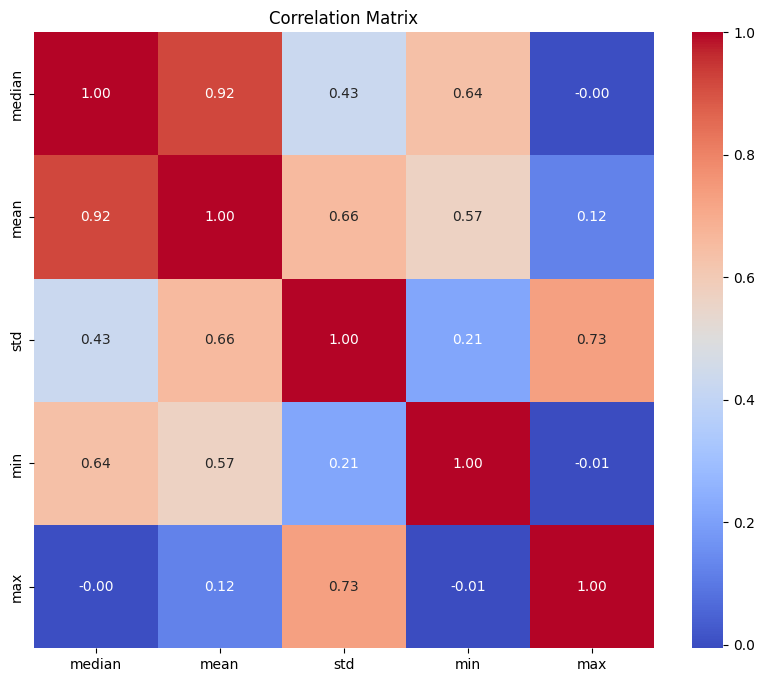

In [74]:
# Calculate the correlation matrix
corr_matrix = df[features].corr()

# Display the correlation matrix
print(corr_matrix)

# Optional: Visualize the correlation matrix using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()